# Vector borne transimission

In [2]:
import string         #(module for string)
import sys            #(module system)
import numpy as np    #(module mathematical stuff)
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import itertools
import networkx as nx
from scipy.integrate import solve_ivp
from scipy.linalg import solve, inv, eigvals

## Foot-and-Mouth Disease

In [89]:
# parameters (4.2.1.1 Rohani)

#Time (initial and final)
t_i = 0
t_f = 200

#Compartment numbers (for entire Cumbria region)
N_s = 2.64e6     #num of sheep
N_c = 5.12e5     #num of cattle

# Transmission Matrix
susc_s = 1
susc_c = 15
trans_s = 1
trans_c = 1.8

T_ss = trans_s * susc_s
T_cs = trans_s * susc_c
T_sc = trans_c * susc_s
T_cc = trans_c * susc_c

B = np.array([
    [T_cc, T_cs],  # [c<-c, c<-s]
    [T_sc, T_ss],  # [s<-c, s<-s]
], dtype=float) 

#Num of infected sheep (start with 100)
I_c = 1
I_s = 1
R_c = 0
R_s = 0
S_c = N_c - I_c - R_c
S_s = N_s - I_s - R_s

#Natural History
gamma = 1/11

In [90]:
print(B)

[[27.  15. ]
 [ 1.8  1. ]]


Currently the Transmission matrix B is not scaled properly and only shows the ratios between the different transimissions. To have the elements of the matrix be accurate we scale the matrix by a parameter 'b'. We can reverse-construct this parameter by choosing b so that the growth rate of the reported cases matches the real-life observed value of R0 = 2.5.

The b parameter is therefore the ratio between this target R0 value and the current R0 value of the matrix, so that when we scale the transmission matrix by b we do indeed reach the target R0 value.

In [91]:
from numpy.linalg import eigvals

# Next-generation matrix with b=1
K_base = (1.0 / gamma) * np.array([
    [B[0,0] * S_c, B[0,1] * S_c],
    [B[1,0] * S_s, B[1,1] * S_s],
], dtype=float)

rho_base = max(np.real(eigvals(K_base)))
b = 2.5 / rho_base

# The actual transmission matrix
BetaM = b * B

In [92]:
print(BetaM)

[[3.72714655e-07 2.07063697e-07]
 [2.48476436e-08 1.38042465e-08]]


With the transmission matrix properly set up we now construct the ODEs that determine the dynamics of the epidemic.

In [93]:
def FaMD_ODE(t, y):
    Sc, Ic, Rc, Ss, Is, Rs = y

    # forces of infection on cattle and sheep
    lambda_c = BetaM[0,0] * Ic + BetaM[0,1] * Is
    lambda_s = BetaM[1,0] * Ic + BetaM[1,1] * Is

    dSc = -Sc * lambda_c
    dIc =  Sc * lambda_c - gamma * Ic
    dRc =  gamma * Ic

    dSs = -Ss * lambda_s
    dIs =  Ss * lambda_s - gamma * Is
    dRs =  gamma * Is

    return [dSc, dIc, dRc, dSs, dIs, dRs]

In [94]:
t_span = (t_i, t_f)  # days
y0 = [S_c, I_c, R_c, S_s, I_s, R_s]
t_eval = np.linspace(t_span[0], t_span[1], 1001)

sol = solve_ivp(FaMD_ODE, t_span, y0, t_eval=t_eval, rtol=1e-6, atol=1e-9)

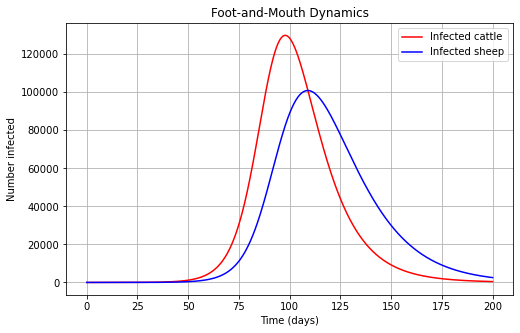

In [95]:
# Unpack
t = sol.t
Sc, Ic, Rc, Ss, Is, Rs = sol.y

# 1) Plot infected cattle vs sheep
plt.figure(figsize=(8,5))
plt.plot(t, Ic, label="Infected cattle", color="red")
plt.plot(t, Is, label="Infected sheep", color="blue")
plt.xlabel("Time (days)")
plt.ylabel("Number infected")
plt.title("Foot-and-Mouth Dynamics")
plt.legend()
plt.grid(True)
plt.show()

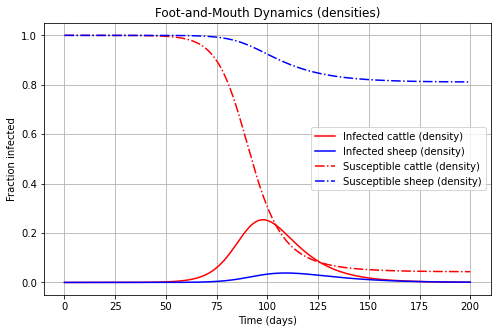

In [96]:
# Convert to densities (fractions of total species population)
Ic_density = Ic / N_c
Is_density = Is / N_s
Sc_density = Sc / N_c
Ss_density = Ss / N_s

# 1) Plot infected cattle vs sheep (as densities)
plt.figure(figsize=(8,5))
plt.plot(t, Ic_density, label="Infected cattle (density)", color="red")
plt.plot(t, Is_density, label="Infected sheep (density)", color="blue")
plt.plot(t, Sc_density, '-.', label="Susceptible cattle (density)", color="red")
plt.plot(t, Ss_density, '-.', label="Susceptible sheep (density)", color="blue")

plt.xlabel("Time (days)")
plt.ylabel("Fraction infected")
plt.title("Foot-and-Mouth Dynamics (densities)")
plt.legend()
plt.grid(True)
plt.show()

In [97]:
#Culling cows
def CullingCows(N_c):
    """Run the FMD ODE model for a given cattle population size."""
    # Initial conditions
    I_c = 0
    I_s = 100
    R_c = 0
    R_s = 0
    S_c = N_c - I_c - R_c
    S_s = N_s - I_s - R_s

    # Next-generation matrix with b=1
    K_base = (1.0 / gamma) * np.array([
        [B[0,0] * S_c, B[0,1] * S_c],
        [B[1,0] * S_s, B[1,1] * S_s],
    ], dtype=float)

    rho_base = max(np.real(eigvals(K_base)))
    b = 2.5 / rho_base

    # The actual transmission matrix
    BetaM = b * B

    t_span = (t_i, t_f)
    y0 = [S_c, I_c, R_c, S_s, I_s, R_s]
    t_eval = np.linspace(t_span[0], t_span[1], 1001)

    sol = solve_ivp(FaMD_ODE, t_span, y0, t_eval=t_eval, rtol=1e-6, atol=1e-9)

    return sol.t, sol.y

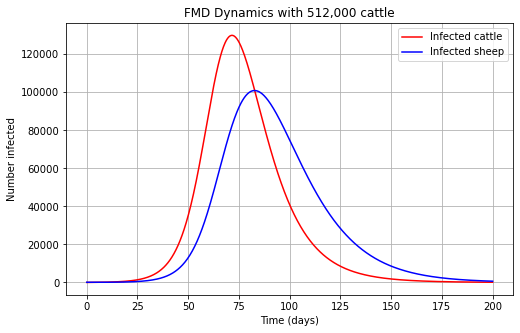

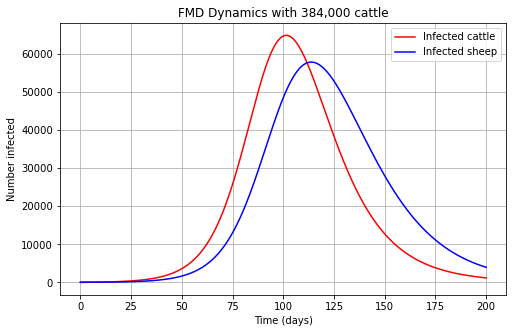

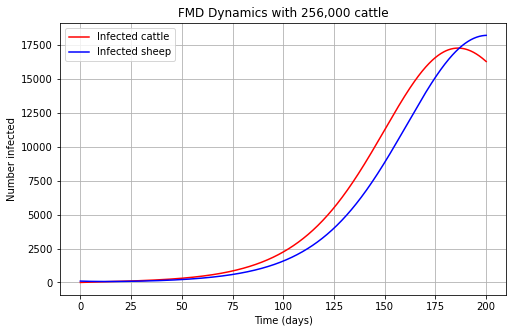

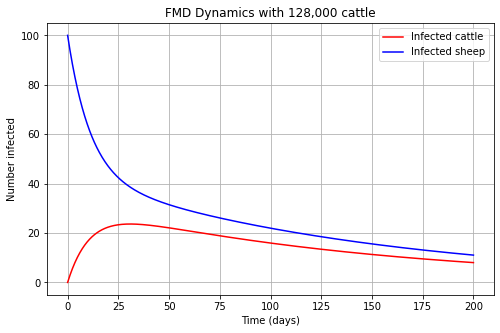

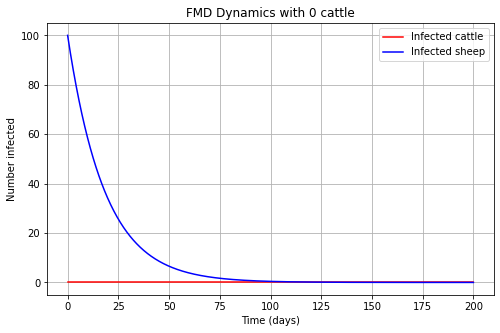

In [98]:
fractions = np.linspace(1, 0, 5)  # 100%, 75%, 50%, 25%, 0% cattle
cattle_levels = [int(f * N_c) for f in fractions]

for Nc in cattle_levels:
    t, (Sc, Ic, Rc, Ss, Is, Rs) = CullingCows(Nc)

    plt.figure(figsize=(8,5))
    plt.plot(t, Ic, label="Infected cattle", color="red")
    plt.plot(t, Is, label="Infected sheep", color="blue")
    plt.xlabel("Time (days)")
    plt.ylabel("Number infected")
    plt.title(f"FMD Dynamics with {Nc:,} cattle")
    plt.legend()
    plt.grid(True)
    plt.show()

In [99]:
fractions = np.linspace(1, 0, 21)  # from 100% to 0%, in 5% steps
total_deaths = []
cull_percents = []
sigma2 = 1/9
gamma2 = 1/3
fatality_rate = 0.4

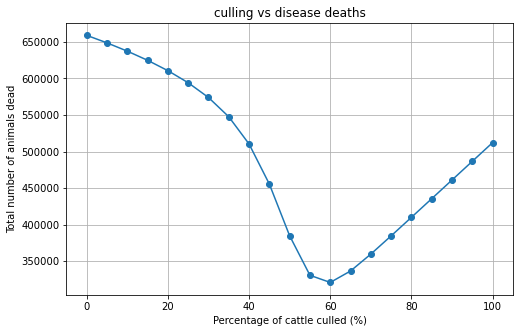

In [100]:
# ---- New loop over culling percentages ----

for f in fractions:
    Nc = int(f * N_c)
    t, (Sc, Ic, Rc, Ss, Is, Rs) = CullingCows(Nc)

    # Disease deaths: 3% of total infected
    total_infected_cattle = Rc[-1] / (1 - fatality_rate)
    total_infected_sheep  = Rs[-1] / (1 - fatality_rate)
    disease_deaths = fatality_rate * (total_infected_cattle + total_infected_sheep)

    # Culling deaths: difference from original cattle pop
    cull_deaths = N_c - Nc

    # Total deaths
    total_deaths.append(disease_deaths + cull_deaths)
    cull_percents.append(100 * (1 - f))

# ---- Plot result ----
plt.figure(figsize=(8,5))
plt.plot(cull_percents, total_deaths, marker="o")
plt.xlabel("Percentage of cattle culled (%)")
plt.ylabel("Total number of animals dead")
plt.title("culling vs disease deaths")
plt.grid(True)
plt.show()

In [39]:
def simulate_SEIR(cull_frac):
    """
    SEIR ODE model with selective culling of infected cattle.
    cull_frac = desired proportion of infected cattle who will eventually be culled (0–1).
    """
    # Map fraction -> per-capita rate
    if cull_frac == 1:
        kappa = 1e6  # very large, approximate instantaneous removal
    else:
        kappa = (cull_frac / (1 - cull_frac)) * gamma2

    # Initial conditions
    E_c, I_c, R_c = 0, 0, 0
    E_s, I_s, R_s = 0, 100, 0
    S_c = N_c - E_c - I_c - R_c
    S_s = N_s - E_s - I_s - R_s

    # Transmission scaling as before
    K_base = (1.0 / gamma2) * np.array([
        [B[0,0] * S_c, B[0,1] * S_c],
        [B[1,0] * S_s, B[1,1] * S_s],
    ], dtype=float)

    rho_base = max(np.real(eigvals(K_base)))
    b = 2.5 / rho_base
    BetaM = b * B

    def SEIR_ODE(t, y):
        Sc, Ec, Ic, Rc, Ss, Es, Is, Rs, D_disease, D_cull = y

        lambda_c = BetaM[0,0] * Ic + BetaM[0,1] * Is
        lambda_s = BetaM[1,0] * Ic + BetaM[1,1] * Is

        # Cattle
        dSc = -lambda_c * Sc
        dEc = lambda_c * Sc - sigma2 * Ec
        dIc = sigma2 * Ec - (gamma2 + kappa) * Ic
        dRc = (1 - fatality_rate) * gamma2 * Ic

        # Sheep
        dSs = -lambda_s * Ss
        dEs = lambda_s * Ss - sigma2 * Es
        dIs = sigma2 * Es - gamma2 * Is
        dRs = (1 - fatality_rate) * gamma * Is

        # Deaths
        dD_disease = fatality_rate * (gamma2 * Ic + gamma2 * Is)
        dD_cull = kappa * Ic

        return [dSc, dEc, dIc, dRc,
                dSs, dEs, dIs, dRs,
                dD_disease, dD_cull]

    y0 = [S_c, E_c, I_c, R_c, S_s, E_s, I_s, R_s, 0, 0]
    t_eval = np.linspace(t_i, t_f, 1001)
    sol = solve_ivp(SEIR_ODE, (t_i, t_f), y0, t_eval=t_eval,
                    rtol=1e-6, atol=1e-9)

    Sc, Ec, Ic, Rc, Ss, Es, Is, Rs, D_disease, D_cull = sol.y
    total_deaths = D_disease[-1] + D_cull[-1]
    return total_deaths

In [40]:
cull_fracs = np.linspace(0, 1.0, 21)  # from 0% to 100% in 5% steps
total_deaths = []

for f in cull_fracs:
    deaths = simulate_SEIR(f)
    total_deaths.append(deaths)

# Plot
plt.figure(figsize=(8,5))
plt.plot(cull_fracs*100, total_deaths, marker="o")
plt.xlabel("Percentage of infected cattle culled (%)")
plt.ylabel("Total number of animals dead")
plt.title("Deaths vs infected cattle culled (SEIR model)")
plt.grid(True)
plt.show()

KeyboardInterrupt: 

## A multi-species epidemic model with spatial dynamics

In [10]:
def allocate_farms(N_s, N_c, n, p_s=0.3, p_c=0.2,
                   sheep_logn_mu=5.0, sheep_logn_sigma=1.0,
                   cattle_logn_mu=3.5, cattle_logn_sigma=1.0,
                   rng=None):
    """
    Split total sheep and cattle populations into n farms.
    
    Parameters
    ----------
    N_s : float
        Total number of sheep in region.
    N_c : float
        Total number of cattle in region.
    n : int
        Number of farms.
    p_s : float
        Fraction of farms that are sheep-only.
    p_c : float
        Fraction of farms that are cattle-only.
        Remaining fraction will be mixed.
    sheep_logn_mu, sheep_logn_sigma : float
        Parameters of lognormal distribution for sheep farm sizes.
    cattle_logn_mu, cattle_logn_sigma : float
        Parameters of lognormal distribution for cattle farm sizes.
    rng : np.random.Generator
        Optional random number generator.
    """
    if rng is None:
        rng = np.random.default_rng()
        
    n_sheep_only = int(round(p_s * n))
    n_cattle_only = int(round(p_c * n))
    n_mixed = n - n_sheep_only - n_cattle_only
    
    farm_types = (["sheep_only"] * n_sheep_only +
                  ["cattle_only"] * n_cattle_only +
                  ["mixed"] * n_mixed)
    rng.shuffle(farm_types)
    
    # generate raw samples
    sheep_sizes = np.zeros(n)
    cattle_sizes = np.zeros(n)
    
    for i, ftype in enumerate(farm_types):
        if ftype == "sheep_only":
            sheep_sizes[i] = np.exp(rng.normal(sheep_logn_mu, sheep_logn_sigma))
        elif ftype == "cattle_only":
            cattle_sizes[i] = np.exp(rng.normal(cattle_logn_mu, cattle_logn_sigma))
        else:  # mixed
            sheep_sizes[i] = np.exp(rng.normal(sheep_logn_mu, sheep_logn_sigma))
            cattle_sizes[i] = np.exp(rng.normal(cattle_logn_mu, cattle_logn_sigma))
            # Optionally bias sheep up relative to cattle
            sheep_sizes[i] *= rng.uniform(2, 10)
    
    # scale so totals match N_s and N_c
    if sheep_sizes.sum() > 0:
        sheep_sizes = sheep_sizes / sheep_sizes.sum() * N_s
    if cattle_sizes.sum() > 0:
        cattle_sizes = cattle_sizes / cattle_sizes.sum() * N_c
    
    df = pd.DataFrame({
        "farm_id": np.arange(n),
        "type": farm_types,
        "sheep": sheep_sizes.round().astype(int),
        "cattle": cattle_sizes.round().astype(int)
    })
    
    return df

In [11]:
df = allocate_farms(N_s, N_c, n=100, p_s=0.3, p_c=0.2)

print(df.head())
print("Totals:", df.sheep.sum(), "sheep,", df.cattle.sum(), "cattle")

   farm_id        type  sheep  cattle
0        0  sheep_only   5523       0
1        1       mixed  40438    2844
2        2       mixed  40123    3911
3        3       mixed  94278   23848
4        4       mixed  43052    2819
Totals: 2640001 sheep, 512000 cattle


In [12]:
def visualise_farms(df):
    # compute totals and cattle fractions
    df["total"] = df["sheep"] + df["cattle"]
    df["cattle_frac"] = df["cattle"] / df["total"].replace(0, np.nan)

    fig, ax = plt.subplots(figsize=(8,6))
    scatter = ax.scatter(
        x=df["sheep"],
        y=df["cattle"],
        c=df["cattle_frac"],
        s=df["total"]/200,  # adjust divisor to control bubble size
        cmap="coolwarm",
        alpha=0.6,
        edgecolor="k"
    )
    cbar = plt.colorbar(scatter, ax=ax)
    cbar.set_label("Cattle fraction (0=all sheep, 1=all cattle)")

    ax.set_xlabel("Number of sheep")
    ax.set_ylabel("Number of cattle")
    ax.set_title("Farm sizes and species composition")

    # optional: log scale if there is a wide range of herd sizes
    # ax.set_xscale("log")
    # ax.set_yscale("log")

    plt.tight_layout()
    plt.show()

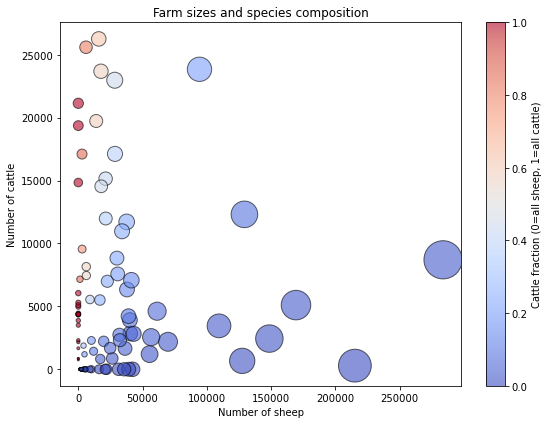

In [13]:
visualise_farms(df)

In [14]:
def assign_positions(df, box_km=(100.0, 80.0), rng=None):
    """Assign x,y coordinates in kilometers within bounding box (0,0) to (box_km)."""
    if rng is None:
        rng = np.random.default_rng()
    n = len(df)
    xs = rng.uniform(0, box_km[0], size=n)
    ys = rng.uniform(0, box_km[1], size=n)
    df = df.copy()
    df['x'] = xs
    df['y'] = ys
    return df

In [15]:
def distance_matrix(x, y):
    coords = np.vstack([x, y]).T
    d = np.sqrt(((coords[:, None, :] - coords[None, :, :])**2).sum(axis=2))
    return d  # shape (n,n)

def build_species_mobility(df, species,
                           distance_scale_km=20.0,
                           origin_move_rate_mean=0.02,
                           dest_size_power=0.8,
                           dest_pref_mixed=0.4,
                           dest_pref_same=1.0,
                           dest_pref_other=0.0,
                           threshold_frac=0.001,
                           rng=None):
    """
    Build mobility matrix M (n x n) for given species ('sheep' or 'cattle').

    Parameters:
    - df: DataFrame with columns 'x','y','sheep','cattle','type'
    - distance_scale_km: kernel scale (exponential decay). Smaller -> more local moves.
    - origin_move_rate_mean: mean fraction (per time unit) of animals that leave an origin farm.
       This is the baseline outflow rate; can be further scaled by farm size.
    - dest_size_power: exponent: attractiveness ∝ (dest_total) ** dest_size_power.
    - dest_pref_mixed: weight for mixed farms (relative to same-species-only farms).
    - dest_pref_same: weight for same-type-only farms (should be 1.0 typically).
    - dest_pref_other: weight to other-type-only farms (often 0: impossible).
    - threshold_frac: only keep edges with probability fraction >= threshold_frac (for sparse visualisation).
    Returns:
    - M: n x n numpy array with M[p,q] = rate from q -> p, columns sum to zero.
    - P_offdiag: n x n pre-normalised off-diagonal probabilities (p!=q) for visualisation (not necessarily sparse).
    """
    if rng is None:
        rng = np.random.default_rng()
    n = len(df)
    x = df['x'].values
    y = df['y'].values
    d = distance_matrix(x, y)  # km

    # base kernel: exponential decay with distance
    # kernel[p,q] = exp(-d[p,q] / distance_scale_km)
    kernel = np.exp(-d / distance_scale_km)

    # destination preference by farm type for this species
    dest_weights = np.zeros(n)
    for i, t in enumerate(df['type'].values):
        if species == 'sheep':
            if t == 'sheep_only':
                dest_weights[i] = dest_pref_same
            elif t == 'mixed':
                dest_weights[i] = dest_pref_mixed
            else:  # cattle_only
                dest_weights[i] = dest_pref_other
        elif species == 'cattle':
            if t == 'cattle_only':
                dest_weights[i] = dest_pref_same
            elif t == 'mixed':
                dest_weights[i] = dest_pref_mixed
            else:
                dest_weights[i] = dest_pref_other
        else:
            raise ValueError("species must be 'sheep' or 'cattle'")

    dest_total = (df['sheep'] + df['cattle']).values
    
    size_attr = np.power(dest_total + 1.0, dest_size_power)
    dest_attr = dest_weights * size_attr

    # Build raw (un-normalised) weights for p != q: W[p,q] = kernel[p,q] * dest_attr[p]
    W = kernel * dest_attr[:, None]  # shape (n,n) broadcasting dest_attr over columns

    # remove self-loop attractiveness for off-diagonals (we model movement off origin separately)
    np.fill_diagonal(W, 0.0)

    # Normalize per origin column q to make probabilities of going to each destination
    # For columns where sum == 0 (no allowed destinations), keep zeros
    col_sums = W.sum(axis=0)
    # To avoid division by zero, create P_offdiag and set columns with zero sum to zero
    P_offdiag = np.zeros_like(W)
    nonzero_cols = col_sums > 0
    P_offdiag[:, nonzero_cols] = W[:, nonzero_cols] / col_sums[None, nonzero_cols]

    # Decide origin-specific movement rate (fraction leaving per time unit) -- can scale with origin farm size
    origin_size = df[species].values
    # standardise origin size and convert to a per-origin move rate around origin_move_rate_mean
    # origin_move_rate = origin_move_rate_mean * (origin_size / avg_size)^0.5  (tune exponent)
    avg_origin_size = np.maximum(1.0, origin_size.mean())
    origin_move_rate = origin_move_rate_mean * np.power((origin_size + 1.0) / avg_origin_size, 0.5)
    # ensure small farms still have small but nonzero move rates
    origin_move_rate = np.clip(origin_move_rate, 1e-6, 1.0)

    # Build M_offdiag: off-diagonal rates = origin_move_rate[q] * P_offdiag[p,q]
    M = np.zeros((n, n))
    for q in range(n):
        if nonzero_cols[q]:
            M[:, q] = origin_move_rate[q] * P_offdiag[:, q]
        else:
            M[:, q] = 0.0
    # zero-out diagonal temporarily
    np.fill_diagonal(M, 0.0)

    # Optionally threshold tiny edges for sparsity (for plotting); doesn't affect normalisation of columns though.
    # For the model we keep full precision; but for plotting we will only show edges >= threshold
    # Now set diagonal M[q,q] = -sum_{p!=q} M[p,q] so columns sum to zero
    col_out_sums = M.sum(axis=0)
    for q in range(n):
        M[q, q] = -col_out_sums[q]

    return M, P_offdiag

In [16]:
def plot_multilayer(df, M_sheep, M_cattle,
                    p_edge_show=0.002,
                    max_edges_per_layer=1000,
                    figsize=(12,10)):
    """
    Plot farms and overlay directed edges for sheep & cattle layers.
    - p_edge_show: only show edges whose off-diagonal probability >= p_edge_show (fraction)
    - max_edges_per_layer: limit edges shown to avoid clutter (keeps strongest edges)
    """
    n = len(df)
    fig, ax = plt.subplots(figsize=figsize)

    # farm marker: size by total animals, color by cattle fraction
    total = df['sheep'] + df['cattle'] + 1.0  # avoid zeros
    cattle_frac = df['cattle'] / total
    sizes = np.sqrt(total)  # perceptual scaling; tune as needed

    sc = ax.scatter(df['x'], df['y'], s=sizes, c=cattle_frac, cmap='coolwarm', alpha=0.85, edgecolor='k', linewidth=0.3)
    cbar = plt.colorbar(sc, ax=ax)
    cbar.set_label("Cattle fraction (0 = all sheep, 1 = all cattle)")

    ax.set_xlabel("x (km)")
    ax.set_ylabel("y (km)")
    ax.set_title("Farm locations with multilayer mobility edges (sheep & cattle)")

    # helper to draw edges from M (show only p!=q entries)
    def draw_edges(M, color='green', alpha=0.6, width_scale=5.0, label=None):
        # We will extract off-diagonal positive entries
        M_off = M.copy()
        np.fill_diagonal(M_off, 0.0)
        # flatten edges
        rows, cols = np.where(M_off > 0)
        weights = M_off[rows, cols]
        if len(weights) == 0:
            return
        # filter by threshold fractional absolute value
        thr = np.quantile(weights, 1 - min(0.999, max(0.0, p_edge_show)))
        # but simpler: keep edges above absolute threshold p_edge_show
        keep_mask = weights >= p_edge_show
        rows = rows[keep_mask]; cols = cols[keep_mask]; weights = weights[keep_mask]
        # if too many edges, only keep top-k
        if len(weights) > max_edges_per_layer:
            idxs = np.argsort(weights)[-max_edges_per_layer:]
            rows = rows[idxs]; cols = cols[idxs]; weights = weights[idxs]
        # draw using lines
        for (p, q, w) in zip(rows, cols, weights):
            x0, y0 = df.loc[q, ['x', 'y']]
            x1, y1 = df.loc[p, ['x', 'y']]
            linewidth = np.clip(w * width_scale, 0.1, 3.0)
            ax.annotate("",
                        xy=(x1, y1), xycoords='data',
                        xytext=(x0, y0), textcoords='data',
                        arrowprops=dict(arrowstyle='->', color=color, alpha=alpha, lw=linewidth))
        if label:
            ax.plot([], [], color=color, label=label, alpha=alpha, linewidth=3)

    # draw sheep edges (green)
    draw_edges(M_sheep, color='tab:green', alpha=0.6, width_scale=80.0, label='sheep transfers')
    # draw cattle edges (purple)
    draw_edges(M_cattle, color='tab:purple', alpha=0.6, width_scale=80.0, label='cattle transfers')

    ax.legend(loc='upper right')
    plt.tight_layout()
    plt.show()

In [17]:
if __name__ == "__main__":
    # Cumbria totals you provided
    N_s = 2.64e6
    N_c = 5.12e5

    # number of farm nodes you want
    n = 800  # tune between ~200-5000 depending on compute & viz performance

    # create farm populations
    df = allocate_farms(N_s=N_s, N_c=N_c, n=n, p_s=0.30, p_c=0.20, sheep_logn_mu=5.0, sheep_logn_sigma=1.05,
                        cattle_logn_mu=3.5, cattle_logn_sigma=0.95, rng=np.random.default_rng(42))

    # assign fake spatial positions (rectangular approx of Cumbria)
    df = assign_positions(df, box_km=(120.0, 90.0), rng=np.random.default_rng(123))

    # build mobility layers
    # sheep can't go to cattle-only farms -> dest_pref_other = 0
    M_sheep, P_sheep = build_species_mobility(df, 'sheep',
                                              distance_scale_km=25.0,
                                              origin_move_rate_mean=0.015,
                                              dest_size_power=0.7,
                                              dest_pref_mixed=0.5,
                                              dest_pref_same=1.0,
                                              dest_pref_other=0.0,
                                              threshold_frac=1e-4,
                                              rng=np.random.default_rng(1))

    # cattle can't go to sheep-only farms -> dest_pref_other = 0 for cattle (i.e., sheep-only weight 0)
    # but often cattle move to mixed farms and cattle-only farms.
    M_cattle, P_cattle = build_species_mobility(df, 'cattle',
                                                distance_scale_km=30.0,
                                                origin_move_rate_mean=0.01,
                                                dest_size_power=0.7,
                                                dest_pref_mixed=0.6,
                                                dest_pref_same=1.0,
                                                dest_pref_other=0.0,
                                                threshold_frac=1e-4,
                                                rng=np.random.default_rng(2))

In [18]:
print("M_sheep column sums (should be ~0):", np.round(M_sheep.sum(axis=0)[:10], 6))
print("M_cattle column sums (should be ~0):", np.round(M_cattle.sum(axis=0)[:10], 6))

M_sheep column sums (should be ~0): [ 0.  0.  0. -0. -0.  0.  0.  0.  0.  0.]
M_cattle column sums (should be ~0): [ 0. -0.  0. -0. -0.  0.  0. -0. -0. -0.]


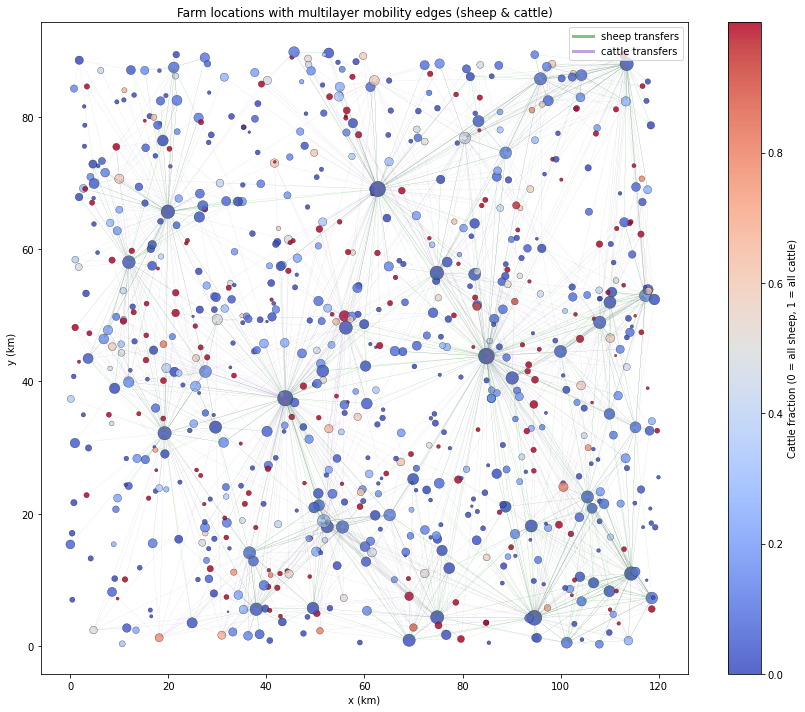

In [19]:
plot_multilayer(df, M_sheep, M_cattle, p_edge_show=1e-4, max_edges_per_layer=1200)

In [20]:
def make_ode_fun_from_params(s, n, betas, Ms, d, eps, gamma):
    def deriv(t, y):
        dydt = np.zeros_like(y)
        def idx(i, p, comp):
            base = (i * n + p) * 4
            return base + comp
        # build arrays of S,E,I,R and N per species/patch
        S = np.zeros((s, n)); E = np.zeros((s, n)); I = np.zeros((s, n)); Rv = np.zeros((s, n)); N = np.zeros((s, n))
        for i in range(s):
            for p in range(n):
                S[i,p] = y[idx(i,p,0)]
                E[i,p] = y[idx(i,p,1)]
                I[i,p] = y[idx(i,p,2)]
                Rv[i,p]= y[idx(i,p,3)]
                N[i,p] = S[i,p] + E[i,p] + I[i,p] + Rv[i,p]
        # compute derivatives
        for i in range(s):
            for p in range(n):
                # births and natural death simplified: d_ip * (N_ip - S_ip) moves as in paper:
                birth_minus_death_S = d[i,p] * (N[i,p] - S[i,p])
                # infection sum over j
                infect = 0.0
                for j in range(s):
                    Njp = N[j,p]
                    if Njp > 0:
                        infect += betas[i, j, p] * S[i,p] * I[j,p] / Njp
                # movement in/out for each compartment using Ms[i] mobility
                move_in_S = np.sum(Ms[i][p, :] * S[i, :])
                move_out_S = np.sum(Ms[i][:, p] * S[i, p])  # careful: Ms[i][q,p] is rate p->q? (we have M[p,q]= q->p)
                # With our convention M[p,q] = rate q -> p
                # sum_q M[p,q] * S[i,q] is inflow; sum_q M[q,p] * S[i,p] is outflow
                # The above is correct: move_in_S = sum_pq M[p,q]*S[q]; move_out_S = sum_q M[q,p]*S[p]
                # But we already used that form.
                dS = birth_minus_death_S - infect + move_in_S - move_out_S

                # E
                move_in_E = np.sum(Ms[i][p, :] * E[i, :])
                move_out_E = np.sum(Ms[i][:, p] * E[i, p])
                dE = infect - (d[i,p] + eps[i,p]) * E[i,p] + move_in_E - move_out_E

                # I
                move_in_I = np.sum(Ms[i][p, :] * I[i, :])
                move_out_I = np.sum(Ms[i][:, p] * I[i, p])
                dI = eps[i,p] * E[i,p] - (d[i,p] + gamma[i,p]) * I[i,p] + move_in_I - move_out_I

                # R
                move_in_R = np.sum(Ms[i][p, :] * Rv[i, :])
                move_out_R = np.sum(Ms[i][:, p] * Rv[i, p])
                dR = gamma[i,p] * I[i,p] - d[i,p] * Rv[i,p] + move_in_R - move_out_R

                dydt[idx(i,p,0)] = dS
                dydt[idx(i,p,1)] = dE
                dydt[idx(i,p,2)] = dI
                dydt[idx(i,p,3)] = dR
        return dydt
    return deriv

In [21]:
def run_simulation_and_plot():
    # Cumbria totals provided
    N_s = 2.64e6
    N_c = 5.12e5
    n = 800  # number of farms (tune to fit memory / speed)

    # create farms
    df = allocate_farms(N_s, N_c, n=n, p_s=0.30, p_c=0.20,
                        sheep_logn_mu=5.0, sheep_logn_sigma=1.05,
                        cattle_logn_mu=3.5, cattle_logn_sigma=0.95,
                        rng=np.random.default_rng(42))
    df = assign_positions(df, box_km=(120.0, 90.0), rng=np.random.default_rng(123))

    # build mobility layers
    M_sheep, _ = build_species_mobility(df, 'sheep',
                                    distance_scale_km=25.0,
                                    origin_move_rate_mean=0.015,
                                    dest_size_power=0.7,
                                    dest_pref_mixed=0.5,
                                    dest_pref_same=1.0,
                                    dest_pref_other=0.0,
                                    rng=np.random.default_rng(1))
    M_cattle, _ = build_species_mobility(df, 'cattle',
                                     distance_scale_km=30.0,
                                     origin_move_rate_mean=0.01,
                                     dest_size_power=0.7,
                                     dest_pref_mixed=0.6,
                                     dest_pref_same=1.0,
                                     dest_pref_other=0.0,
                                     rng=np.random.default_rng(2))

    Ms = [M_sheep, M_cattle]  # list for species 0 and 1

    # epidemiological params (example placeholders - adjust to your scenario)
    s = 2
    # arrays shape (s,n)
    eps = np.zeros((s, n))     # rate E -> I (1/incubation period)
    gamma = np.zeros((s, n))   # recovery rate (1/infectious period)
    d = np.zeros((s, n))       # natural mortality / turnover (set small)
    # example: incubation ~4 days -> eps = 1/4, infectious period ~7 days -> gamma = 1/7
    eps[:, :] = 1.0 / 4.0
    gamma[:, :] = 1.0 / 7.0
    d[:, :] = 1.0 / (77.0 * 365.0)  # negligible per-day natural turnover

    # infection coefficients beta_{i j p} shape (s, s, n)
    # beta_{i j p}: infection of species i from infectious individuals of species j in patch p
    betas = np.zeros((s, s, n))
    # set base transmissibilities and cross-species multipliers:
    # cattle are more infectious and more susceptible than sheep:
    base_beta_sheep_from_sheep = 0.25
    base_beta_sheep_from_cattle = 0.6   # cattle more infectious to sheep
    base_beta_cattle_from_sheep = 0.3   # sheep less infectious to cattle
    base_beta_cattle_from_cattle = 0.9  # cattle -> cattle high

    for p in range(n):
        betas[0, 0, p] = base_beta_sheep_from_sheep   # sheep <- sheep
        betas[0, 1, p] = base_beta_sheep_from_cattle  # sheep <- cattle
        betas[1, 0, p] = base_beta_cattle_from_sheep  # cattle <- sheep
        betas[1, 1, p] = base_beta_cattle_from_cattle # cattle <- cattle

    # initial conditions: S = counts, E,I,R = 0, then seed 100 exposed sheep in one farm with >=100 sheep
    # flatten state vector ordering as described earlier
    y0 = np.zeros(4 * s * n)
    def idx(i, p, comp):
        return (i * n + p) * 4 + comp

    # set initial S to farm counts
    for i in range(s):
        for p in range(n):
            if i == 0:
                y0[idx(i,p,0)] = df.loc[p, 'sheep']
            else:
                y0[idx(i,p,0)] = df.loc[p, 'cattle']
            # E,I,R already zero

    # pick a farm that has >=100 sheep
    candidate_idx = df.index[df['sheep'] >= 100].tolist()
    if len(candidate_idx) == 0:
        raise RuntimeError("No farm has >= 100 sheep. Reduce seed or change generator.")
    seed_farm = candidate_idx[0]  # choose first such farm
    # seed 100 exposed sheep: move 100 from S to E
    y0[idx(0, seed_farm, 1)] = 100.0
    y0[idx(0, seed_farm, 0)] -= 100.0
    print(f"Seeding 100 exposed sheep at farm {seed_farm} (sheep before seeding: {df.loc[seed_farm,'sheep']})")

    # build ODE fun and integrate
    ode_fun = make_ode_fun_from_params(s, n, betas, Ms, d, eps, gamma)

    t_max = 200.0  # days
    t_eval = np.linspace(0, t_max, 1001)
    sol = solve_ivp(ode_fun, (0.0, t_max), y0, t_eval=t_eval, method='RK45', atol=1e-8, rtol=1e-6)
    print("Integration done. Status:", sol.message)

    # extract I trajectories and compute species-level infected density
    I_sheep = np.zeros_like(t_eval)
    I_cattle = np.zeros_like(t_eval)
    total_sheep = df['sheep'].sum()
    total_cattle = df['cattle'].sum()
    for k, t in enumerate(t_eval):
        # species 0 sheep: indices (0*p + p)*4 + 2 etc
        I_s = 0.0
        I_c = 0.0
        for p in range(n):
            I_s += sol.y[idx(0, p, 2), k]
            I_c += sol.y[idx(1, p, 2), k]
        I_sheep[k] = I_s / total_sheep
        I_cattle[k] = I_c / total_cattle

    # plot
    plt.figure(figsize=(8,5))
    plt.plot(t_eval, I_sheep, label='Sheep infected density (I_s / total_sheep)', color='tab:green')
    plt.plot(t_eval, I_cattle, label='Cattle infected density (I_c / total_cattle)', color='tab:purple')
    plt.xlabel("Days since onset")
    plt.ylabel("Fraction infected (density)")
    plt.title("Epidemic: infected density vs days (sheep & cattle)")
    plt.legend()
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()

    # return relevant outputs if needed
    return {
        'df': df,
        'M_sheep': M_sheep,
        'M_cattle': M_cattle,
        'sol': sol,
        't_eval': t_eval,
        'I_sheep': I_sheep,
        'I_cattle': I_cattle
    }


Seeding 100 exposed sheep at farm 1 (sheep before seeding: 2488)
Integration done. Status: The solver successfully reached the end of the integration interval.


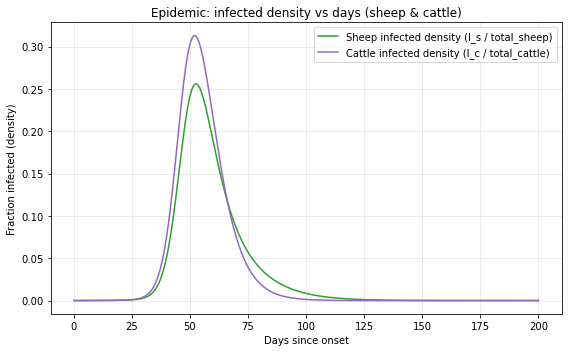

ValueError: too many values to unpack (expected 4)

In [22]:
if __name__ == "__main__":
    res, _, _, sol = run_simulation_and_plot()

In [23]:
def plot_farm_composition(df, figsize=(10,8)):
    """
    Plot farms with color = cattle fraction (as in your original code).
    """
    fig, ax = plt.subplots(figsize=figsize)
    total = df['sheep'] + df['cattle'] + 1.0  # avoid zeros
    cattle_frac = df['cattle'] / total
    sizes = np.sqrt(total)

    sc = ax.scatter(df['x'], df['y'], s=sizes, c=cattle_frac,
                    cmap="coolwarm", alpha=0.9, edgecolor="k", linewidth=0.3)
    cbar = plt.colorbar(sc, ax=ax)
    cbar.set_label("Cattle fraction (0 = all sheep, 1 = all cattle)")

    ax.set_xlabel("x (km)")
    ax.set_ylabel("y (km)")
    ax.set_title("Farm composition (sheep vs cattle)")
    plt.tight_layout()
    plt.show()

In [24]:
def plot_epidemic_state(df, sol, t_eval, day, n, s=2, figsize=(10,8)):
    """
    Plot farms with color = fraction of animals exposed or infected (all species combined).
    - df: farm DataFrame with x,y coords
    - sol: ODE solution from solve_ivp
    - t_eval: array of time points used
    - day: time (in days) to plot
    - n: number of farms
    - s: number of species (default=2: sheep, cattle)
    """
    # helper index
    def idx(i, p, comp):
        return (i * n + p) * 4 + comp

    # find index in solution closest to 'day'
    t_idx = np.argmin(np.abs(t_eval - day))

    infected_frac = np.zeros(n)
    for p in range(n):
        total_animals = 0
        infected_animals = 0
        for i in range(s):
            S = sol.y[idx(i,p,0), t_idx]
            E = sol.y[idx(i,p,1), t_idx]
            I = sol.y[idx(i,p,2), t_idx]
            R = sol.y[idx(i,p,3), t_idx]
            total_animals += S + E + I + R
            infected_animals += E + I
        if total_animals > 0:
            infected_frac[p] = infected_animals / total_animals

    sizes = np.sqrt(df['sheep'] + df['cattle'] + 1.0)

    fig, ax = plt.subplots(figsize=figsize)
    sc = ax.scatter(df['x'], df['y'], s=sizes, c=infected_frac,
                    cmap="Reds", vmin=0, vmax=1,
                    alpha=0.9, edgecolor="k", linewidth=0.3)
    cbar = plt.colorbar(sc, ax=ax)
    cbar.set_label("Fraction exposed or infected")

    ax.set_xlabel("x (km)")
    ax.set_ylabel("y (km)")
    ax.set_title(f"Epidemic state at day {day}")
    plt.tight_layout()
    plt.show()

In [25]:
def plot_epidemic_snapshots(df, sol, t_eval, n, step=20, t_max=200):
    """
    Create epidemic spread plots every 'step' days until t_max.
    """
    for day in range(0, int(t_max)+1, step):
        plot_epidemic_state(df, sol, t_eval, day, n, s=2)

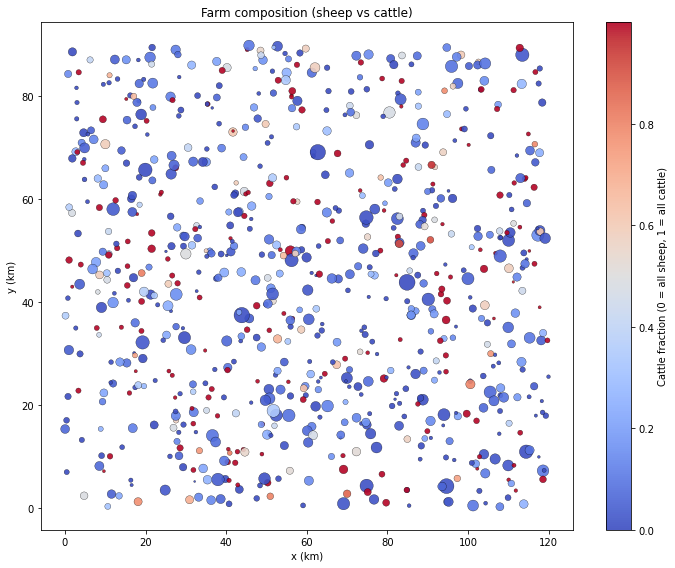

IndexError: index 3200 is out of bounds for axis 0 with size 6

In [26]:
# First, baseline composition
plot_farm_composition(df)

n_farms = len(df)   # actual number of farms in your DataFrame
plot_epidemic_snapshots(df, sol, t_eval, n=n_farms, step=20, t_max=100)

In [33]:
import matplotlib.animation as animation

def run_simulation_and_animate(df, n_frames=100, interval=20):
    """
    Run the epidemic simulation and animate farms geographically over time.
    
    - n_frames: number of frames in the animation (time points)
    - interval: delay between frames in ms
    """
    # --------------------------
    # Cumbria totals & farms
    # --------------------------
    N_s = 2.64e6
    N_c = 5.12e5
    n = 800

    #df = allocate_farms(N_s, N_c, n=n, p_s=0.30, p_c=0.20,
    #                    sheep_logn_mu=5.0, sheep_logn_sigma=1.05,
    #                    cattle_logn_mu=3.5, cattle_logn_sigma=0.95,
    #                    rng=np.random.default_rng(42))
    #df = assign_positions(df, box_km=(120.0, 90.0), rng=np.random.default_rng(123))

    # --------------------------
    # Mobility matrices
    # --------------------------
    M_sheep, _ = build_species_mobility(df, 'sheep', distance_scale_km=25.0,
                                        origin_move_rate_mean=0.015,
                                        dest_size_power=0.7,
                                        dest_pref_mixed=0.5,
                                        dest_pref_same=1.0,
                                        dest_pref_other=0.0,
                                        rng=np.random.default_rng(1))
    M_cattle, _ = build_species_mobility(df, 'cattle', distance_scale_km=30.0,
                                         origin_move_rate_mean=0.01,
                                         dest_size_power=0.7,
                                         dest_pref_mixed=0.6,
                                         dest_pref_same=1.0,
                                         dest_pref_other=0.0,
                                         rng=np.random.default_rng(2))

    Ms = [M_sheep, M_cattle]

    # --------------------------
    # Epidemiological parameters
    # --------------------------
    s = 2
    eps = np.ones((s, n)) / 4.0
    gamma = np.ones((s, n)) / 7.0
    d = np.ones((s, n)) / (77.0*365.0)

    betas = np.zeros((s, s, n))
    for p in range(n):
        betas[0,0,p] = 0.25
        betas[0,1,p] = 0.6
        betas[1,0,p] = 0.3
        betas[1,1,p] = 0.9

    # --------------------------
    # Initial conditions
    # --------------------------
    y0 = np.zeros(4*s*n)
    def idx(i,p,comp):
        return (i*n + p)*4 + comp

    for i in range(s):
        for p in range(n):
            y0[idx(i,p,0)] = df.loc[p,'sheep'] if i==0 else df.loc[p,'cattle']

    candidate_idx = df.index[df['sheep'] >= 100].tolist()
    seed_farm = candidate_idx[0]
    y0[idx(0, seed_farm, 1)] = 100.0
    y0[idx(0, seed_farm, 0)] -= 100.0
    print(f"Seeding 100 exposed sheep at farm {seed_farm} (sheep before seeding: {df.loc[seed_farm,'sheep']})")

    # --------------------------
    # Solve ODE
    # --------------------------
    ode_fun = make_ode_fun_from_params(s, n, betas, Ms, d, eps, gamma)
    t_max = 120.0
    t_eval = np.linspace(0, t_max, n_frames)
    sol = solve_ivp(ode_fun, (0.0, t_max), y0, t_eval=t_eval, method='RK45', atol=1e-8, rtol=1e-6)
    print("Integration done. Status:", sol.message)

    # --------------------------
    # Animation setup
    # --------------------------
    fig, ax = plt.subplots(figsize=(10,8))
    sizes = np.sqrt(df['sheep'] + df['cattle'] + 1.0)
    sc = ax.scatter(df['x'], df['y'], s=sizes, c=np.zeros(n),
                    cmap="Reds", vmin=0, vmax=1, alpha=0.9,
                    edgecolor="k", linewidth=0.3)
    cbar = plt.colorbar(sc, ax=ax)
    cbar.set_label("Fraction exposed or infected")
    ax.set_xlabel("x (km)")
    ax.set_ylabel("y (km)")
    ax.set_title("Epidemic spreading over farms")

    def update(frame):
        infected_frac = np.zeros(n)
        for p in range(n):
            total_animals = 0
            infected_animals = 0
            for i in range(s):
                S = sol.y[idx(i,p,0), frame]
                E = sol.y[idx(i,p,1), frame]
                I = sol.y[idx(i,p,2), frame]
                R = sol.y[idx(i,p,3), frame]
                total_animals += S + E + I + R
                infected_animals += E + I
            if total_animals > 0:
                infected_frac[p] = infected_animals / total_animals
        sc.set_array(infected_frac)
        ax.set_title(f"Epidemic spreading - Day {t_eval[frame]:.1f}")
        return sc,

    anim = animation.FuncAnimation(fig, update, frames=n_frames, interval=interval, blit=True)
    plt.close(fig)  # prevents double plot in notebooks
    return anim, df, sol, t_eval

In [34]:
anim, df2, sol, t_eval = run_simulation_and_animate(df)
from IPython.display import HTML
HTML(anim.to_jshtml())

Seeding 100 exposed sheep at farm 1 (sheep before seeding: 2488)
Integration done. Status: The solver successfully reached the end of the integration interval.


In [35]:
anim.save("epidemic_animation.gif", writer="pillow", fps=10)

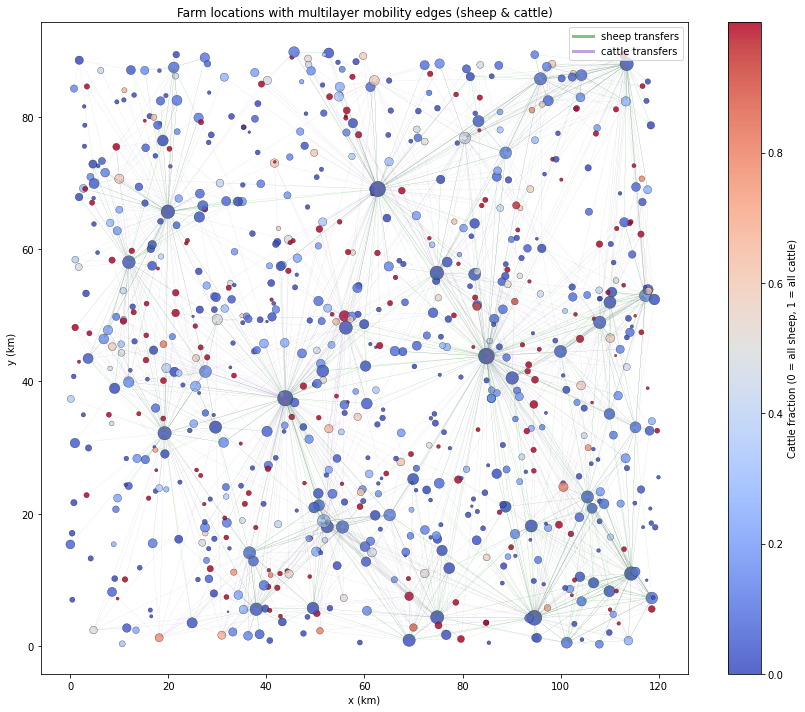

In [36]:
plot_multilayer(df2, M_sheep, M_cattle, p_edge_show=1e-4, max_edges_per_layer=1200)

### Optimising the geographical layout to minimise epidemic spread

In [37]:
def layout_farms_with_clusters(df, n_clusters=3, cluster_radius_km=10.0, buffer_width_km=15.0,
                               box_km=(120.0, 90.0), rng=np.random.default_rng(42)):
    """
    Re-layout farms so that:
    - Cattle-only farms are placed in clusters.
    - Mixed farms on the periphery of these clusters.
    - Sheep-only farms form buffers between clusters.

    Parameters
    ----------
    df : pd.DataFrame
        Must contain ['farm_id','type','sheep','cattle']
    n_clusters : int
        Number of cattle farm clusters.
    cluster_radius_km : float
        Radius of the cattle-only farm core (km).
    buffer_width_km : float
        Thickness of the sheep-only buffer around each cluster (km).
    box_km : (float, float)
        Width and height of the simulation region.
    rng : np.random.Generator
        Random number generator for reproducibility.

    Returns
    -------
    df_out : pd.DataFrame
        Same farms but with new 'x','y' coordinates.
    centers : list
        Coordinates of cattle cluster centers.
    """

    n = len(df)

    # --- Step 1: assign cluster centers (well-separated inside box)
    x_max, y_max = box_km
    centers = []
    tries = 0
    while len(centers) < n_clusters and tries < 1000:
        cand = np.array([rng.uniform(0.1*x_max, 0.9*x_max),
                         rng.uniform(0.1*y_max, 0.9*y_max)])
        if all(np.linalg.norm(cand - c) > (2*(cluster_radius_km+buffer_width_km)) for c in centers):
            centers.append(cand)
        tries += 1
    centers = np.array(centers)

    # --- Step 2: split farms by type
    cattle_farms = df[df['type']=="cattle_only"].copy()
    mixed_farms  = df[df['type']=="mixed"].copy()
    sheep_farms  = df[df['type']=="sheep_only"].copy()

    # --- Step 3: place cattle farms in cluster cores
    coords_cattle = []
    for _, farm in cattle_farms.iterrows():
        cluster = rng.integers(0, n_clusters)
        angle = rng.uniform(0, 2*np.pi)
        r = rng.uniform(0, cluster_radius_km)
        x = centers[cluster,0] + r*np.cos(angle)
        y = centers[cluster,1] + r*np.sin(angle)
        coords_cattle.append((x,y))
    cattle_farms["x"], cattle_farms["y"] = zip(*coords_cattle)

    # --- Step 4: place mixed farms on cluster periphery
    coords_mixed = []
    for _, farm in mixed_farms.iterrows():
        cluster = rng.integers(0, n_clusters)
        angle = rng.uniform(0, 2*np.pi)
        r = rng.uniform(cluster_radius_km, cluster_radius_km+buffer_width_km)
        x = centers[cluster,0] + r*np.cos(angle)
        y = centers[cluster,1] + r*np.sin(angle)
        coords_mixed.append((x,y))
    mixed_farms["x"], mixed_farms["y"] = zip(*coords_mixed)

    # --- Step 5: place sheep-only farms everywhere else as buffers
    coords_sheep = []
    for _, farm in sheep_farms.iterrows():
        placed = False
        while not placed:
            x = rng.uniform(0, x_max)
            y = rng.uniform(0, y_max)
            d = np.min(np.linalg.norm(centers - np.array([x,y]), axis=1))
            if d > cluster_radius_km:  # keep them outside cattle cores
                placed = True
        coords_sheep.append((x,y))
    sheep_farms["x"], sheep_farms["y"] = zip(*coords_sheep)

    # --- Step 6: recombine
    df_out = pd.concat([cattle_farms, mixed_farms, sheep_farms], ignore_index=True)

    return df_out, centers

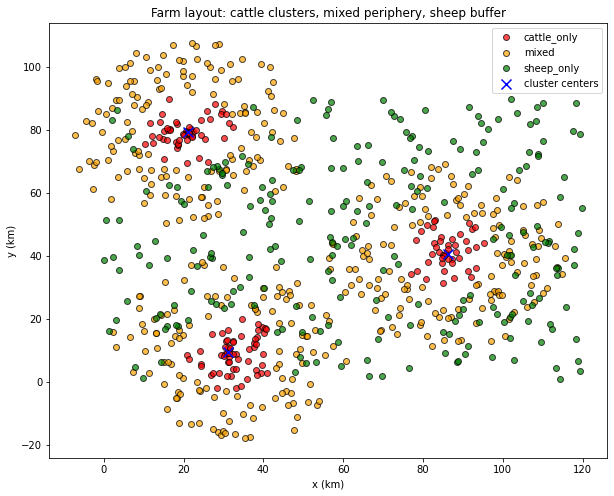

In [38]:
df_out, centers = layout_farms_with_clusters(df, n_clusters=3,
                                             cluster_radius_km=12,
                                             buffer_width_km=18,
                                             box_km=(120,90))

plt.figure(figsize=(10,8))
colors = {'cattle_only':'red','mixed':'orange','sheep_only':'green'}
for t, group in df_out.groupby('type'):
    plt.scatter(group['x'], group['y'], label=t, c=colors[t], alpha=0.7, edgecolor="k")
plt.scatter(centers[:,0], centers[:,1], c='blue', marker='x', s=100, label='cluster centers')
plt.legend()
plt.xlabel("x (km)")
plt.ylabel("y (km)")
plt.title("Farm layout: cattle clusters, mixed periphery, sheep buffer")
plt.show()

In [39]:
anim, df2, sol, t_eval = run_simulation_and_animate(df_out)
from IPython.display import HTML
HTML(anim.to_jshtml())

Seeding 100 exposed sheep at farm 160 (sheep before seeding: 2488)
Integration done. Status: The solver successfully reached the end of the integration interval.


In [40]:
anim.save("epidemic_animation2.gif", writer="pillow", fps=10)

Of particular interest in the above animation is that it seems like the MIXED farms are the propagators of the epidemic moreso than the CATTLE-ONLY farms. This was a surprise to me at first until I realised how the disease must spread between farms.

Since we start the simulation with 100 infected sheep the disease cannot immediately go to a cattle-only farm - we explicitly do not allow sheep to be transferred to cattle-only farms (obviously). For the infection to get to cattle-only farms an infected sheep must first be transferred to a mixed farm, infect a cow, and then that cow must be transferred to a cattle-only farm.

In fact, looking at the simulation the infected sheep actually begin in a mixed farm and still we see far quicker spread between mixed farms than cattle farms. My hypothesis is that the high mobility into mixed farms (since both cattle and sheep can be transferred there) causes the mixed farms to be the leading drivers of the epidemic.

### Comparing epidemic spread of cattle-only, sheep only and mixed farms

In [52]:
def sample_type_farms(df, farm_type, n=100, rng=None):
    """
    Sample n farms of a given farm_type from df.
    If there are fewer than n farms available, sample with replacement and warn.
    Returns a new DataFrame (copy).
    """
    if rng is None:
        rng = np.random.default_rng()
    avail = df[df['type'] == farm_type]
    m = len(avail)
    if m == 0:
        raise ValueError(f"No farms of type '{farm_type}' available in df.")
    if m < n:
        print(f"Warning: only {m} farms of type '{farm_type}' available; sampling with replacement to get {n}.")
        picked = avail.sample(n=n, replace=True, random_state=rng.integers(1e9)).reset_index(drop=True)
    else:
        picked = avail.sample(n=n, replace=False, random_state=rng.integers(1e9)).reset_index(drop=True)
    # reset farm_id to 0..n-1 for this subset to simplify indexing
    picked = picked.copy()
    picked['farm_id'] = np.arange(len(picked))
    return picked

def build_and_run_sim(df_subset,
                      seed_species='sheep', seed_count=100,
                      # epidemiological params (tweakable)
                      distance_scale_sheep=20.0,
                      distance_scale_cattle=30.0,
                      origin_move_rate_sheep=0.02,
                      origin_move_rate_cattle=0.01,
                      t_max=200.0, n_tsteps=1001,
                      rng=np.random.default_rng(1234)):
    """
    Build mobility, params and run the ODE model on a subset df (n farms).
    seed_species: 'sheep' or 'cattle' - species to seed with `seed_count` exposed animals.
    Returns: dict with df, sol, t_eval, time series totals:
      S_total(t), EI_total(t)  (EI = E + I for both species combined)
    """
    df = df_subset.copy().reset_index(drop=True)
    n = len(df)
    s = 2  # species 0: sheep, 1: cattle

    # assign uniform positions
    df = assign_positions(df, box_km=(100.0, 80.0), rng=rng)

    # build mobility matrices
    M_sheep, _ = build_species_mobility(df, 'sheep',
                                        distance_scale_km=distance_scale_sheep,
                                        origin_move_rate_mean=origin_move_rate_sheep,
                                        dest_size_power=0.8,
                                        dest_pref_mixed=0.5,
                                        dest_pref_same=1.0,
                                        dest_pref_other=0.0,
                                        rng=np.random.default_rng(rng.integers(1e9)))
    M_cattle, _ = build_species_mobility(df, 'cattle',
                                         distance_scale_km=distance_scale_cattle,
                                         origin_move_rate_mean=origin_move_rate_cattle,
                                         dest_size_power=0.8,
                                         dest_pref_mixed=0.6,
                                         dest_pref_same=1.0,
                                         dest_pref_other=0.0,
                                         rng=np.random.default_rng(rng.integers(1e9)))
    Ms = [M_sheep, M_cattle]

    # epidemiological params arrays shape (s, n)
    eps = np.ones((s, n)) * (1.0 / 4.0)   # incubation ~4 days
    gamma = np.ones((s, n)) * (1.0 / 7.0) # infectious ~7 days
    d = np.ones((s, n)) * (1.0 / (77.0 * 365.0))

    # betas: keep same base values as before
    betas = np.zeros((s, s, n))
    base_beta_sheep_from_sheep = 0.25
    base_beta_sheep_from_cattle = 0.6
    base_beta_cattle_from_sheep = 0.3
    base_beta_cattle_from_cattle = 0.9
    for p in range(n):
        betas[0, 0, p] = base_beta_sheep_from_sheep
        betas[0, 1, p] = base_beta_sheep_from_cattle
        betas[1, 0, p] = base_beta_cattle_from_sheep
        betas[1, 1, p] = base_beta_cattle_from_cattle

    # initial state vector y0 (4 comps per species per patch)
    y0 = np.zeros(4 * s * n)
    def idx(i, p, comp):
        return (i * n + p) * 4 + comp

    # populate S from df counts
    for i in range(s):
        for p in range(n):
            if i == 0:
                # sheep
                y0[idx(i, p, 0)] = float(df.at[p, 'sheep'])
            else:
                # cattle
                y0[idx(i, p, 0)] = float(df.at[p, 'cattle'])

    # choose seed farm consistent with requested species
    if seed_species == 'sheep':
        candidate_idx = df.index[df['sheep'] >= seed_count].tolist()
        if len(candidate_idx) == 0:
            # fallback: pick farm with highest sheep and seed up to available
            seed_farm = int(df['sheep'].idxmax())
            actual_seed = min(seed_count, int(df.at[seed_farm, 'sheep']))
            print(f"Warning: no farm has >={seed_count} sheep; seeding {actual_seed} sheep at farm {seed_farm}.")
        else:
            seed_farm = candidate_idx[0]
            actual_seed = seed_count
        y0[idx(0, seed_farm, 1)] = actual_seed
        y0[idx(0, seed_farm, 0)] -= actual_seed
        print(f"[seed] seeded {actual_seed} exposed SHEEP at farm {seed_farm}")
    elif seed_species == 'cattle':
        candidate_idx = df.index[df['cattle'] >= seed_count].tolist()
        if len(candidate_idx) == 0:
            seed_farm = int(df['cattle'].idxmax())
            actual_seed = min(seed_count, int(df.at[seed_farm, 'cattle']))
            print(f"Warning: no farm has >={seed_count} cattle; seeding {actual_seed} cattle at farm {seed_farm}.")
        else:
            seed_farm = candidate_idx[0]
            actual_seed = seed_count
        y0[idx(1, seed_farm, 1)] = actual_seed
        y0[idx(1, seed_farm, 0)] -= actual_seed
        print(f"[seed] seeded {actual_seed} exposed CATTLE at farm {seed_farm}")
    else:
        raise ValueError("seed_species must be 'sheep' or 'cattle'")

    # build ODE and integrate
    ode_fun = make_ode_fun_from_params(s, n, betas, Ms, d, eps, gamma)
    t_eval = np.linspace(0.0, t_max, n_tsteps)
    sol = solve_ivp(ode_fun, (0.0, t_max), y0, t_eval=t_eval, method='RK45', atol=1e-8, rtol=1e-6)
    print("Integration done. status:", sol.message)

    # compute S_total and EI_total (E+I) time series
    S_total = np.zeros_like(t_eval)
    EI_total = np.zeros_like(t_eval)
    for k in range(len(t_eval)):
        Ssum = 0.0
        EIsum = 0.0
        for i in range(s):
            for p in range(n):
                Ssum += sol.y[idx(i, p, 0), k]
                EIsum += sol.y[idx(i, p, 1), k] + sol.y[idx(i, p, 2), k]
        S_total[k] = Ssum
        EI_total[k] = EIsum

    return {
        'df': df,
        'M_sheep': M_sheep,
        'M_cattle': M_cattle,
        'sol': sol,
        't_eval': t_eval,
        'S_total': S_total,
        'EI_total': EI_total
    }

In [55]:
def generate_synthetic_df(farm_type, n=100, rng=None):
    """
    Generate n farms of the given farm_type with synthetic sizes.
    - sheep_only: farms have random sheep counts
    - cattle_only: farms have random cattle counts
    - mixed: farms have both
    """
    if rng is None:
        rng = np.random.default_rng()

    if farm_type == "sheep_only":
        sheep = rng.integers(500, 5000, size=n)  # e.g. 500–5000 sheep
        cattle = np.zeros(n, dtype=int)
    elif farm_type == "cattle_only":
        sheep = np.zeros(n, dtype=int)
        cattle = rng.integers(100, 2000, size=n) # e.g. 100–2000 cattle
    elif farm_type == "mixed":
        sheep = rng.integers(1000, 10000, size=n)
        cattle = rng.integers(100, 2000, size=n)
    else:
        raise ValueError("farm_type must be sheep_only, cattle_only, or mixed")

    df = pd.DataFrame({
        "farm_id": np.arange(n),
        "type": [farm_type] * n,
        "sheep": sheep,
        "cattle": cattle
    })
    return df

def compare_three_types(n_per_type=100, t_max=200.0, n_tsteps=1001, rng_seed=12345):
    rng = np.random.default_rng(rng_seed)

    # Generate synthetic datasets
    df_cattle100 = generate_synthetic_df("cattle_only", n=n_per_type, rng=rng)
    df_mixed100  = generate_synthetic_df("mixed",       n=n_per_type, rng=rng)
    df_sheep100  = generate_synthetic_df("sheep_only",  n=n_per_type, rng=rng)
    
    # Run sims
    out_cattle = build_and_run_sim(df_cattle100, seed_species='cattle',
                                   t_max=t_max, n_tsteps=n_tsteps,
                                   rng=np.random.default_rng(rng.integers(1e9)))
    out_mixed  = build_and_run_sim(df_mixed100,  seed_species='sheep',
                                   t_max=t_max, n_tsteps=n_tsteps,
                                   rng=np.random.default_rng(rng.integers(1e9)))
    out_sheep  = build_and_run_sim(df_sheep100,  seed_species='sheep',
                                   t_max=t_max, n_tsteps=n_tsteps,
                                   rng=np.random.default_rng(rng.integers(1e9)))

    # Compute initial totals for density normalization
    N0_cattle = df_cattle100['cattle'].sum() + df_cattle100['sheep'].sum()
    N0_mixed  = df_mixed100['cattle'].sum()  + df_mixed100['sheep'].sum()
    N0_sheep  = df_sheep100['cattle'].sum()  + df_sheep100['sheep'].sum()

    # Convert to densities
    EI_cattle_density = out_cattle['EI_total'] / N0_cattle
    EI_mixed_density  = out_mixed['EI_total']  / N0_mixed
    EI_sheep_density  = out_sheep['EI_total']  / N0_sheep

    S_cattle_density = out_cattle['S_total'] / N0_cattle
    S_mixed_density  = out_mixed['S_total']  / N0_mixed
    S_sheep_density  = out_sheep['S_total']  / N0_sheep

    # Plot comparison: densities
    t = out_cattle['t_eval']
    plt.figure(figsize=(10,6))
    plt.plot(t, EI_cattle_density, label='CATTLE-only (E+I)', linestyle='-', color='tab:red')
    plt.plot(t, EI_mixed_density,  label='MIXED (E+I)',      linestyle='-', color='tab:orange')
    plt.plot(t, EI_sheep_density,  label='SHEEP-only (E+I)', linestyle='-', color='tab:green')
    plt.xlabel("Days")
    plt.ylabel("Fraction exposed + infectious")
    plt.title("Comparison of epidemic spread (E+I densities) across 100-farm scenarios")
    plt.legend()
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10,6))
    plt.plot(t, S_cattle_density, label='CATTLE-only S density', linestyle='--', color='tab:red')
    plt.plot(t, S_mixed_density,  label='MIXED S density',      linestyle='--', color='tab:orange')
    plt.plot(t, S_sheep_density,  label='SHEEP-only S density', linestyle='--', color='tab:green')
    plt.xlabel("Days")
    plt.ylabel("Fraction susceptible")
    plt.title("Comparison of susceptible densities across scenarios")
    plt.legend()
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()

    #return {
    #    'cattle': out_cattle,
    #    'mixed' : out_mixed,
    #    'sheep' : out_sheep,
    #    'df_cattle100': df_cattle100,
    #    'df_mixed100': df_mixed100,
    #    'df_sheep100': df_sheep100
    #}

[seed] seeded 100 exposed CATTLE at farm 0
Integration done. status: The solver successfully reached the end of the integration interval.
[seed] seeded 100 exposed SHEEP at farm 0
Integration done. status: The solver successfully reached the end of the integration interval.
[seed] seeded 100 exposed SHEEP at farm 0
Integration done. status: The solver successfully reached the end of the integration interval.


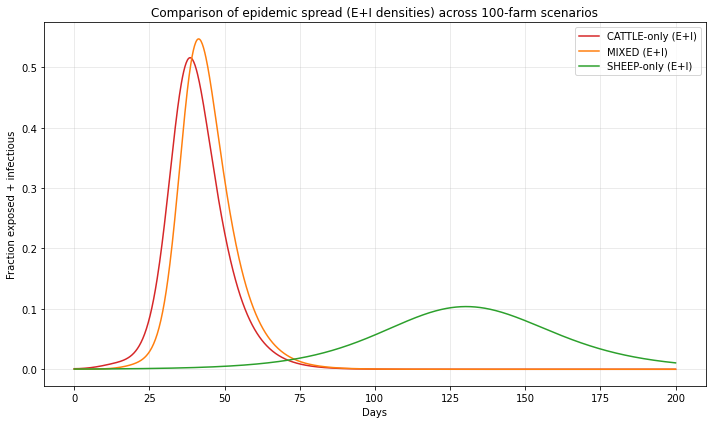

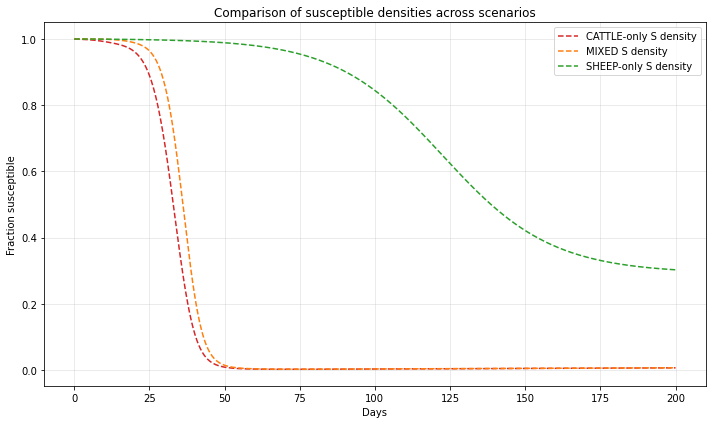

In [56]:
compare_three_types()

Very interesting result here:

- As expected the sheep-only farms have a far slower epidemic spread.

- What is maybe not as intuitive is that the disease profiles of cattle-only and mixed farms are incredibly similar, despite the fact that mixed farms have sheep in them who should be less vulnerable to the disease. In fact, mixed farms are mostly sheep.

- This seems odd to me, and in fact is different for the original mixed-farm dynamics we got for just a single farm. Could the mobility factor really be having such a large impact?

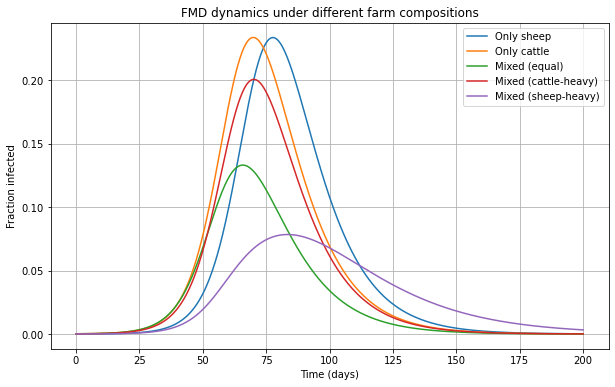

In [11]:
# Time
TSPAN = (0, 200)
t_eval = np.linspace(TSPAN[0], TSPAN[1], 1001)


# Parameters
gamma = 1/11
susc_s, susc_c = 1, 1.8
trans_s, trans_c = 1, 15


T_ss = trans_s * susc_s
T_sc = trans_s * susc_c
T_cs = trans_c * susc_s
T_cc = trans_c * susc_c


B = np.array([
[T_cc, T_cs],
[T_sc, T_ss],
], dtype=float)


# ODE system
def FaMD_ODE(t, y, BetaM):
    Sc, Ic, Rc, Ss, Is, Rs = y
    lambda_c = BetaM[0,0] * Ic + BetaM[0,1] * Is
    lambda_s = BetaM[1,0] * Ic + BetaM[1,1] * Is


    dSc = -Sc * lambda_c
    dIc = Sc * lambda_c - gamma * Ic
    dRc = gamma * Ic


    dSs = -Ss * lambda_s
    dIs = Ss * lambda_s - gamma * Is
    dRs = gamma * Is


    return [dSc, dIc, dRc, dSs, dIs, dRs]


# Function to run scenario
def run_scenario(N_c, N_s, I_c0=0, I_s0=100):
    S_c, S_s = N_c - I_c0, N_s - I_s0
    y0 = [S_c, I_c0, 0, S_s, I_s0, 0]


    # Next-generation matrix
    K_base = (1.0 / gamma) * np.array([
        [B[0,0] * S_c, B[0,1] * S_c],
        [B[1,0] * S_s, B[1,1] * S_s],
    ], dtype=float)
    rho_base = max(np.real(eigvals(K_base)))
    b = 2.5 / rho_base if rho_base > 0 else 0
    BetaM = b * B


    sol = solve_ivp(FaMD_ODE, TSPAN, y0, args=(BetaM,), t_eval=t_eval, rtol=1e-6, atol=1e-9)
    return sol.t, sol.y


# Scenarios
scenarios = {
"Only sheep": (0, 2.64e6),
"Only cattle": (5.12e5, 0),
"Mixed (equal)": (2.5e5, 2.5e5),
"Mixed (cattle-heavy)": (5.12e5, 1e5),
"Mixed (sheep-heavy)": (1e5, 2.64e6)
}


plt.figure(figsize=(10,6))
for label, (Nc, Ns) in scenarios.items():
    t, (Sc, Ic, Rc, Ss, Is, Rs) = run_scenario(Nc, Ns)
    total_pop = Nc + Ns
    infected = Ic + Is
    plt.plot(t, infected/total_pop, label=label)


plt.xlabel("Time (days)")
plt.ylabel("Fraction infected")
plt.title("FMD dynamics under different farm compositions")
plt.legend()
plt.grid(True)
plt.show()